In [ ]:
# Check GPU type
!nvidia-smi

Mon Sep 23 11:06:19 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   53C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [1]:
# Install ultralytics
%%capture
!pip -q install  ultralytics

In [2]:
#@title **Import libraries**
import requests
import pandas as pd
import os
from pathlib import Path
import shutil
from sklearn.model_selection import train_test_split
from tqdm.notebook import tqdm
import cv2
import yaml
import matplotlib.pyplot as plt
from ultralytics import YOLO
import multiprocessing

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


### **Load data from Drive**

For the following cell to work you must (i) be in Google Colaboratory and (ii) have a shortcut of the [data](https://drive.google.com/file/d/16T40TdpaB8VXohm50SySREwrzbuPcJBC/view) in 'My Drive' in your Drive.

In [4]:
from google.colab import drive
drive.mount('/content/drive')
os.chdir('/content/drive/My Drive')
print(os.getcwd())

Mounted at /content/drive
/content/drive/My Drive


# Ver dataset

In [8]:
# Load train and test files
DATA_DIR = Path("/content/drive/MyDrive/challenge_malaria/Lacuna")

train = pd.read_csv(DATA_DIR / 'Train.csv')
test = pd.read_csv(DATA_DIR / 'Test.csv')
ss = pd.read_csv(DATA_DIR / 'SampleSubmission.csv')

# Add an image_path column
train['image_path'] = [Path('/content/drive/MyDrive/challenge_malaria/images/' + x) for x in train.Image_ID]
test['image_path'] = [Path('/content/drive/MyDrive/challenge_malaria/images/' + x) for x in test.Image_ID]

# Map str classes to ints (label encoding targets)
train['class_id'] = train['class'].map({'Trophozoite': 0, 'WBC': 1, 'NEG': 2})

# Preview the head of the train set
train.head()

,Image_ID,class,confidence,ymin,xmin,ymax,xmax,image_path,class_id
0,id_u3q6jdck4j.jpg,Trophozoite,1.0,712,1241,737,1270,/content/drive/MyDrive/challenge_malaria/image...,0
1,id_a6cl90trri.jpg,Trophozoite,1.0,558,1566,600,1604,/content/drive/MyDrive/challenge_malaria/image...,0
2,id_qvc2le9sm8.jpg,Trophozoite,1.0,1317,2788,1448,2914,/content/drive/MyDrive/challenge_malaria/image...,0
3,id_w8xnbd5rvm.jpg,Trophozoite,1.0,925,1744,1041,1823,/content/drive/MyDrive/challenge_malaria/image...,0
4,id_6dop09rk02.jpg,NEG,1.0,0,0,0,0,/content/drive/MyDrive/challenge_malaria/image...,2


In [12]:
train[train['class'] == 'NEG']["Image_ID"].unique().size

688

In [32]:
class_distribution = train[train['class'] != 'NEG'].groupby('image_path')['class_id'].nunique()

# Images with only one unique class
images_with_one_class = class_distribution[class_distribution == 1]

# Images with both classes
images_with_both_classes = class_distribution[class_distribution > 1]

# Print the images that contain only one class
print("Images with only one class:\n", images_with_one_class.size)

# Print the images that contain both classes
print("Images with both classes:\n", images_with_both_classes.size)


# Images with only one unique class (either 0 or 1)
images_with_one_class = class_distribution[class_distribution == 1].index

# Filter the original DataFrame to find which class (0 or 1) these images belong to
single_class_images = train[train['image_path'].isin(images_with_one_class)]

# Now count how many images are class 0 and how many are class 1
class_0_images = single_class_images[single_class_images['class_id'] == 0]['image_path'].nunique()
class_1_images = single_class_images[single_class_images['class_id'] == 1]['image_path'].nunique()

# Print the results
print(f"Images with only class 0: {class_0_images}")
print(f"Images with only class 1: {class_1_images}")

Images with only one class:
 517
Images with both classes:
 1542
Images with only class 0: 476
Images with only class 1: 41


In [34]:
print("cantidad de imagenes", train[train['class'] != 'NEG']["image_path"].unique().size)
print("suma", images_with_one_class.size + images_with_both_classes.size )

cantidad de imagenes 2059
suma 2059


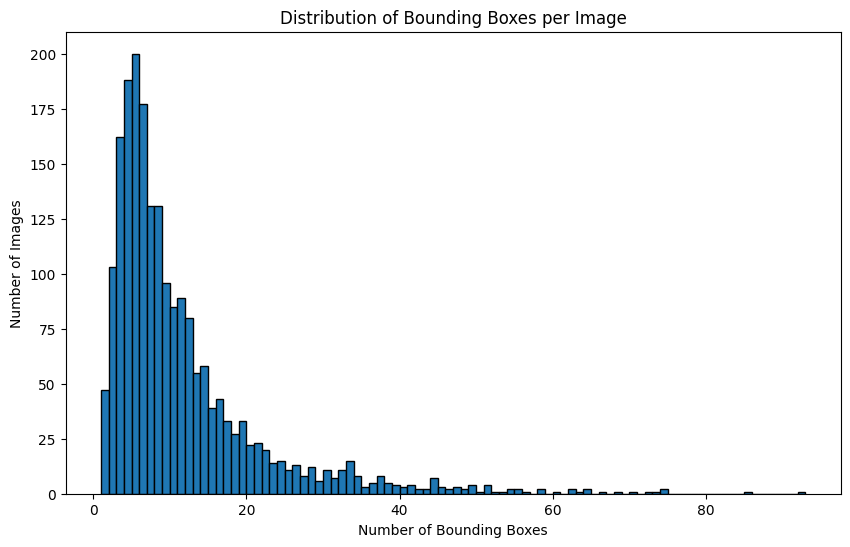

In [44]:
import matplotlib.pyplot as plt

# Group by 'image_path' and count the number of bounding boxes for each image
bounding_boxes_per_image = train[train["class_id"] != 2].groupby('image_path').size()

# Create the histogram
plt.figure(figsize=(10, 6))
plt.hist(bounding_boxes_per_image, bins=range(1, bounding_boxes_per_image.max() + 2), edgecolor='black')

# Add labels and title
plt.title('Distribution of Bounding Boxes per Image')
plt.xlabel('Number of Bounding Boxes')
plt.ylabel('Number of Images')

# Display the histogram
plt.show()


In [37]:
import pandas as pd
import random
import matplotlib.pyplot as plt
from PIL import Image

def display_random_images(df, n):
    # Randomly sample n rows from the DataFrame
    sampled_df = df.sample(n)


    for i, (index, row) in enumerate(sampled_df.iterrows()):
        plt.figure(figsize=(10, 10))
        # Load and display the image
        img_path = row['image_path']  # Assuming image paths are in the 'image_path' column
        img = Image.open(img_path)  # Open the image using PIL
        print(img.size)
        plt.imshow(img)  # Display the image
        plt.axis('off')  # Turn off the axis labels
        plt.show()

# Example usage:
# df = pd.DataFrame({'image_path': ['path_to_image1.jpg', 'path_to_image2.jpg', ...]})
# display_random_images(df, 5)  # Display 5 random images


(4000, 3000)


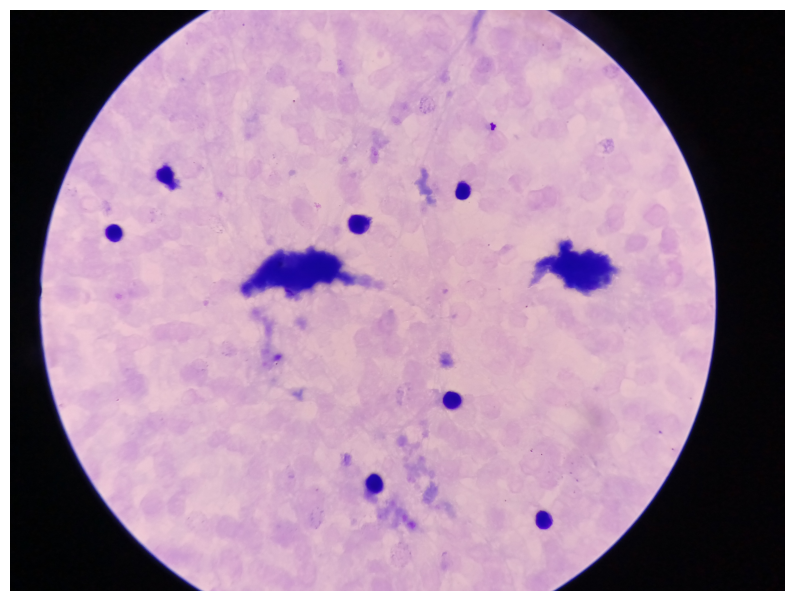

(4000, 3000)


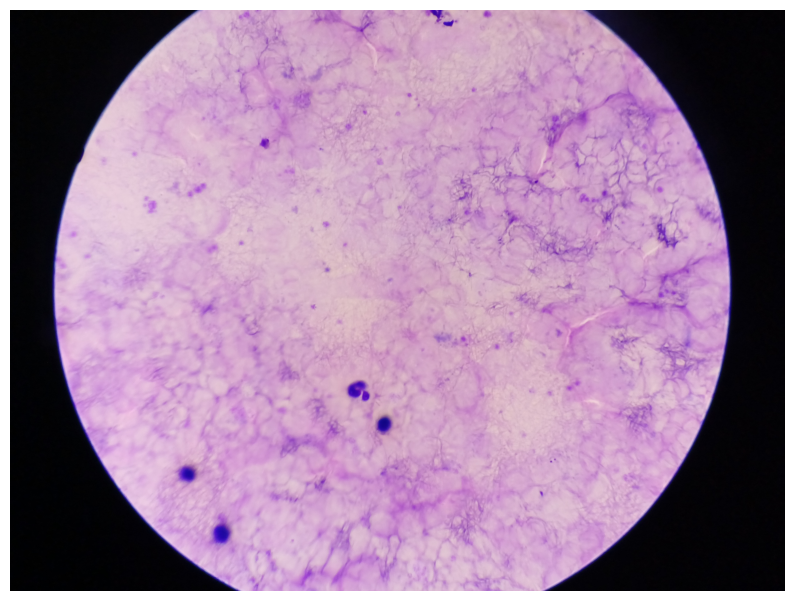

(4000, 3000)


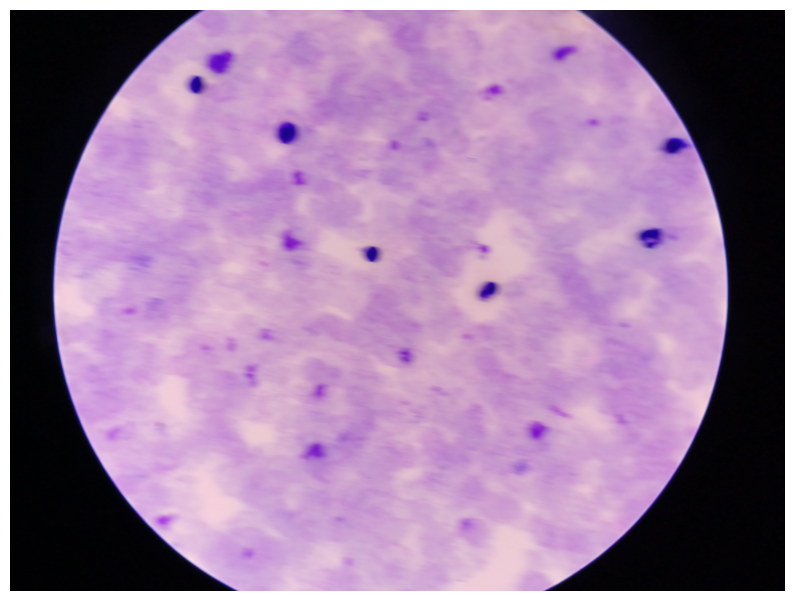

(4000, 3000)


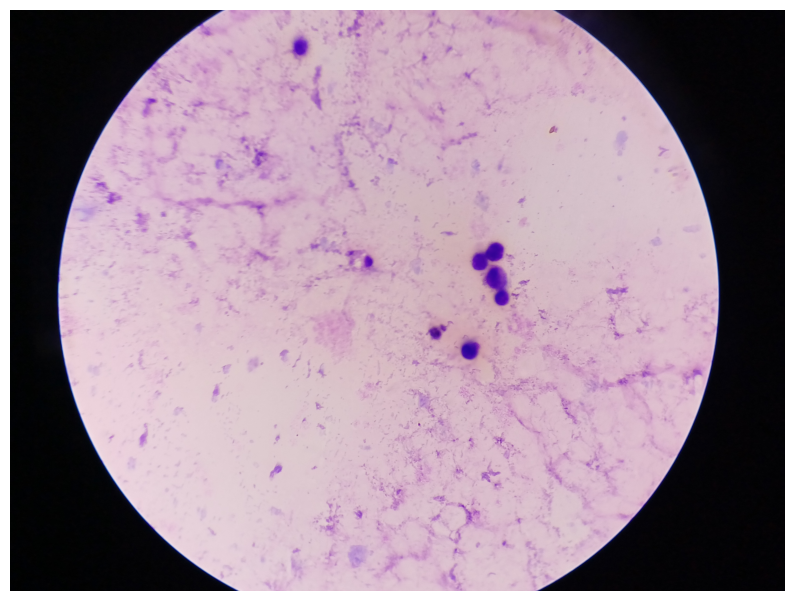

(4000, 3000)


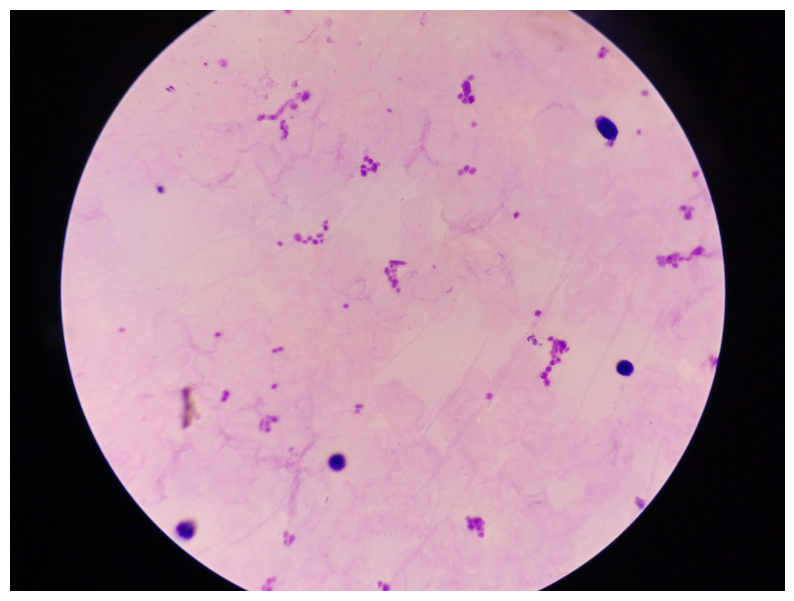

(4000, 3000)


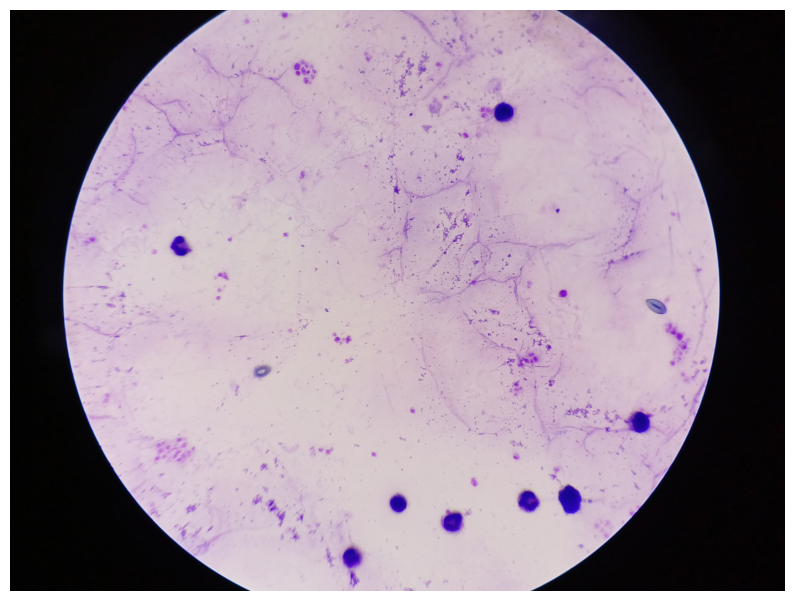

(4000, 3000)


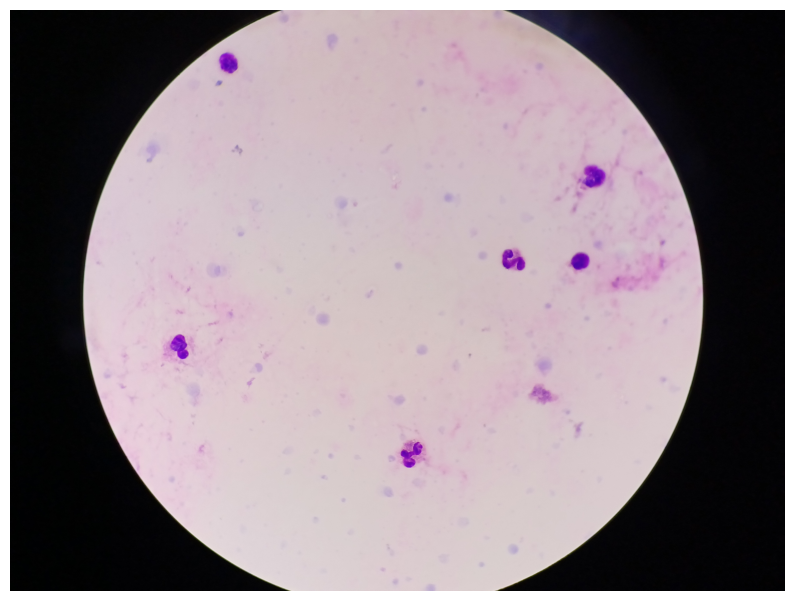

(4000, 3000)


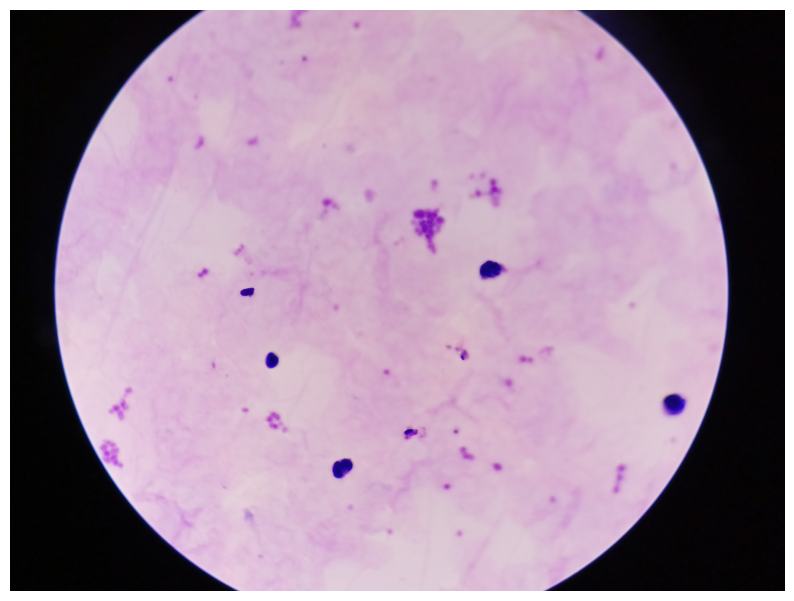

(4000, 3000)


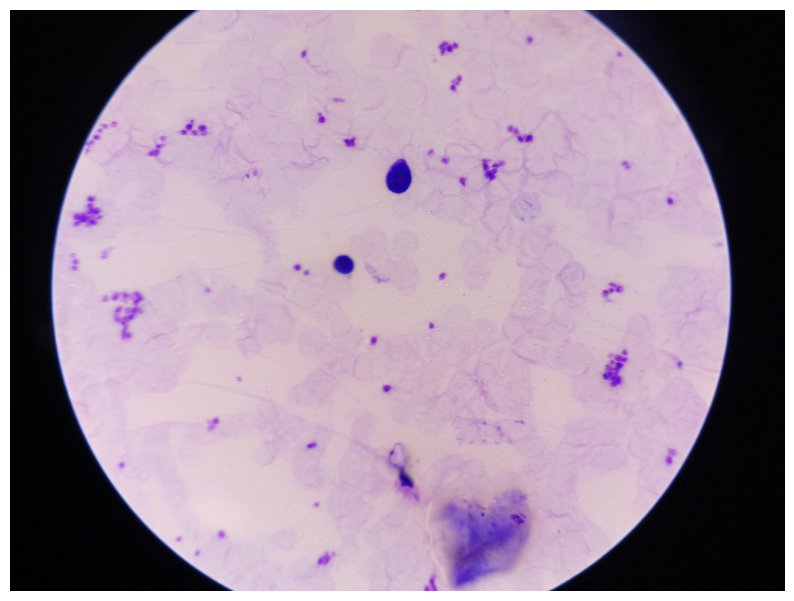

(4000, 3000)


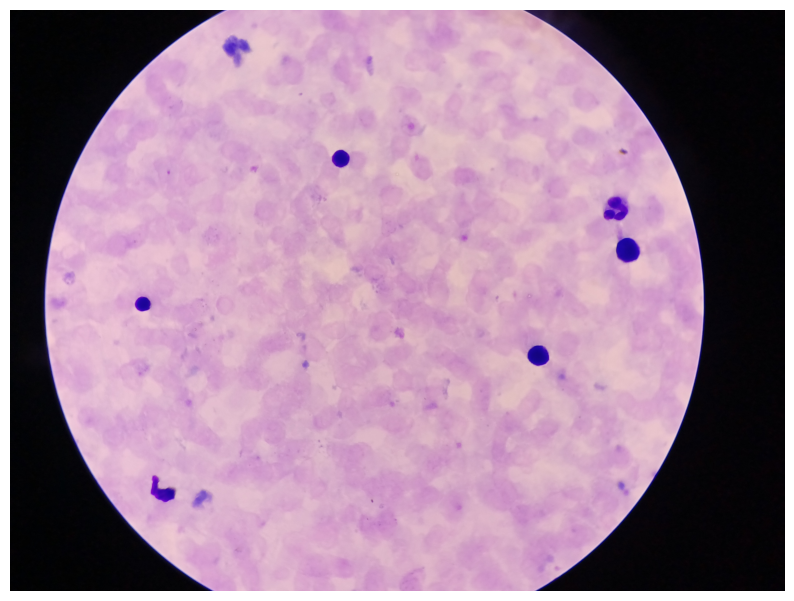

(4000, 3000)


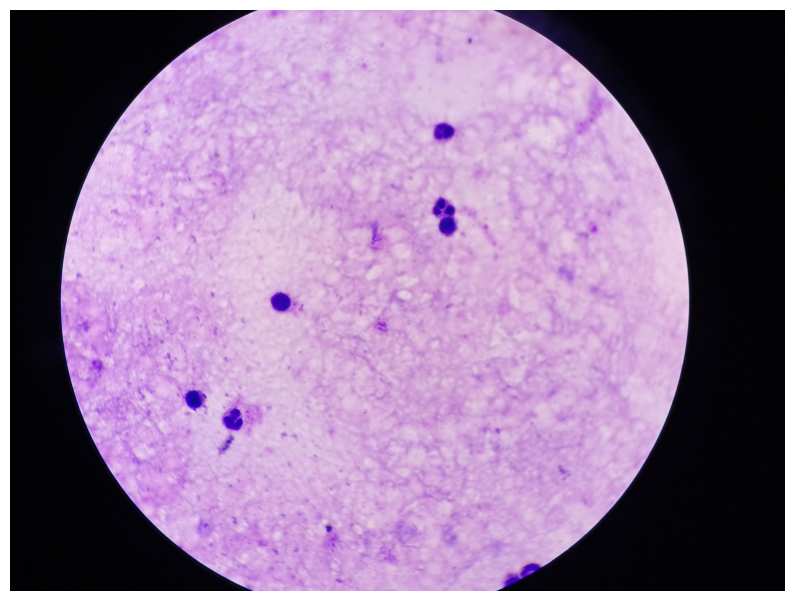

(4000, 3000)


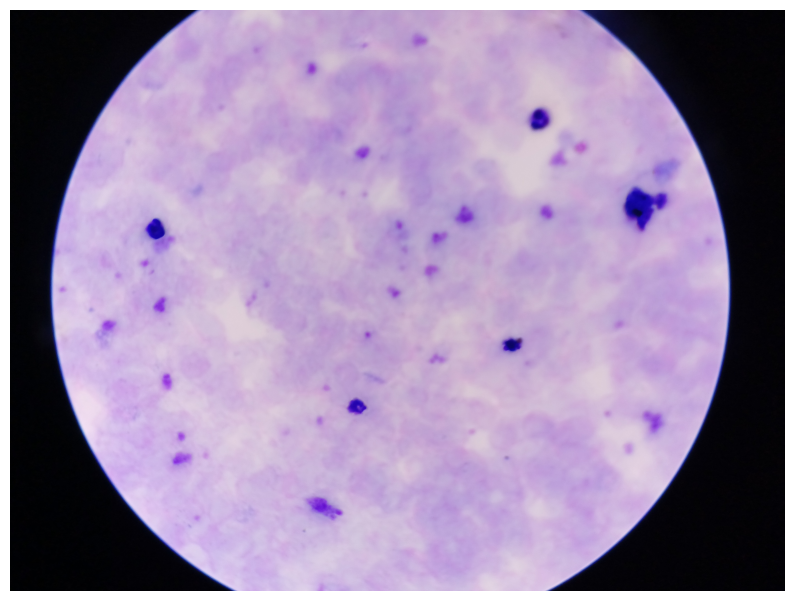

(4000, 3000)


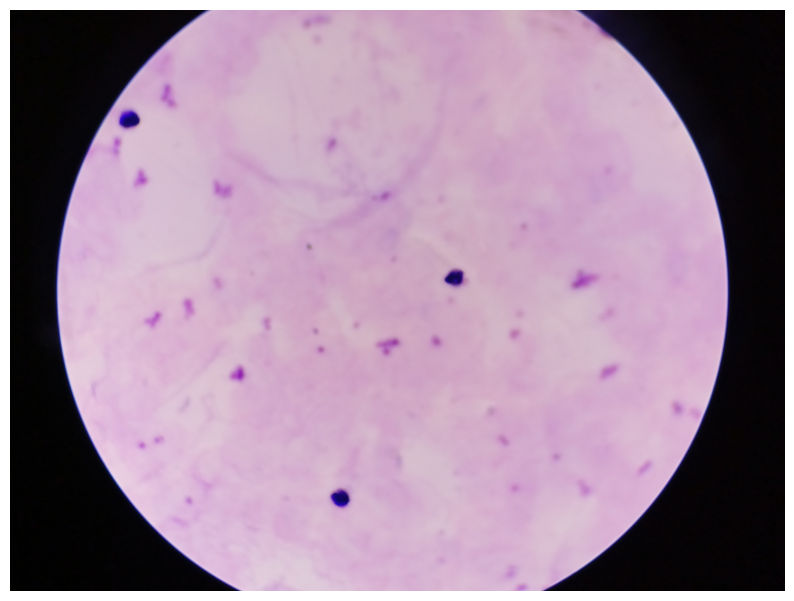

(4000, 3000)


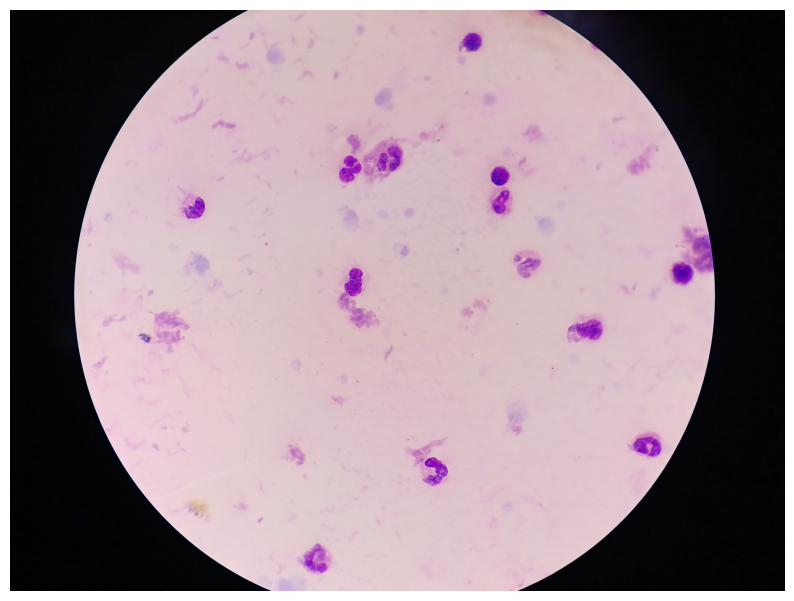

(4000, 3000)


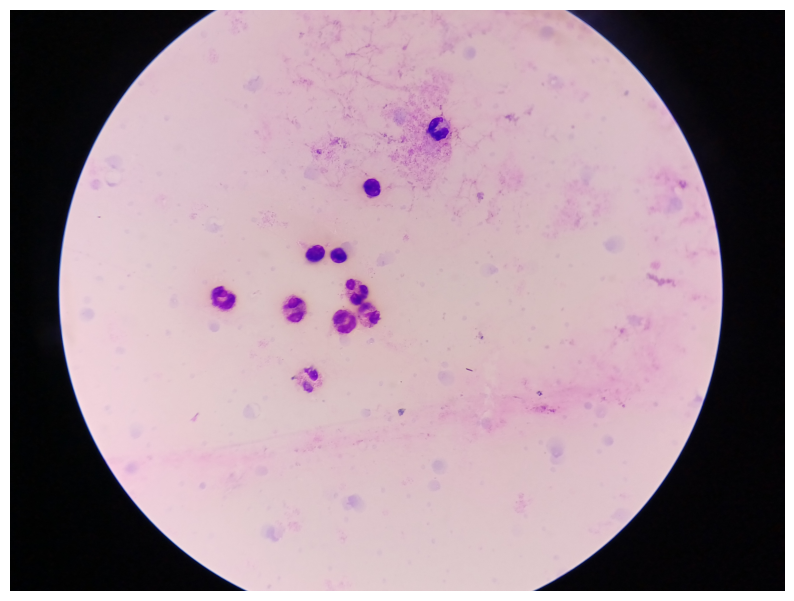

(4000, 3000)


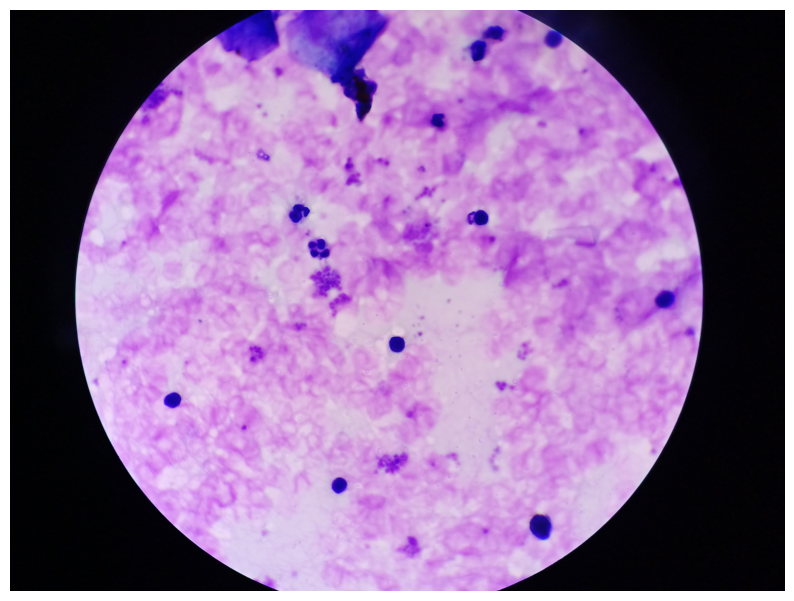

(4000, 3000)


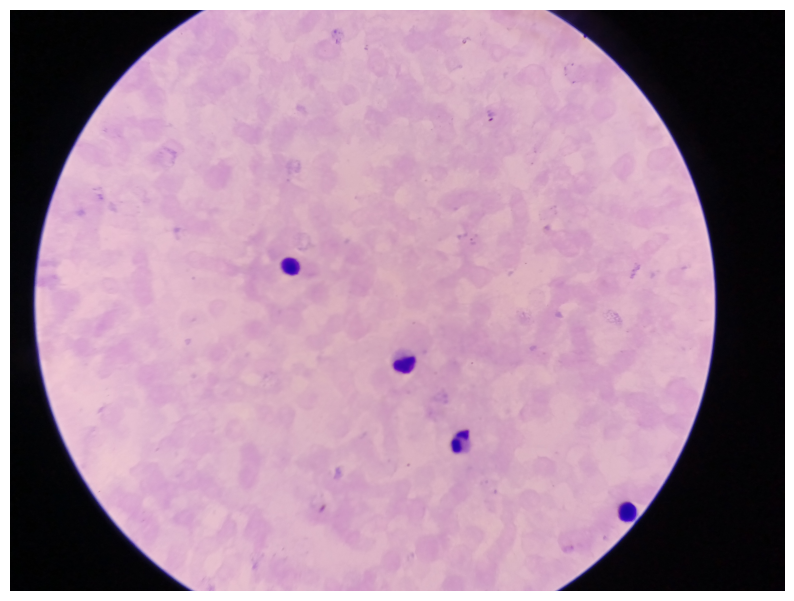

(4000, 3000)


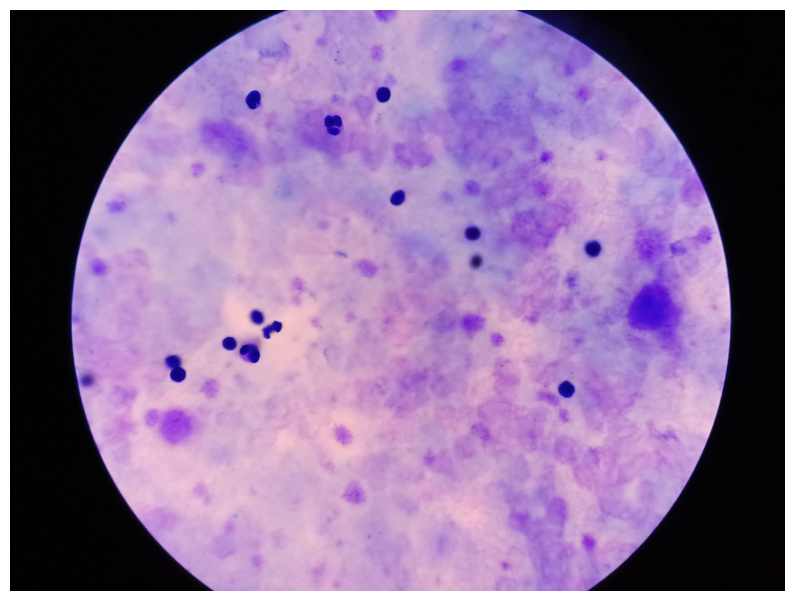

(4000, 3000)


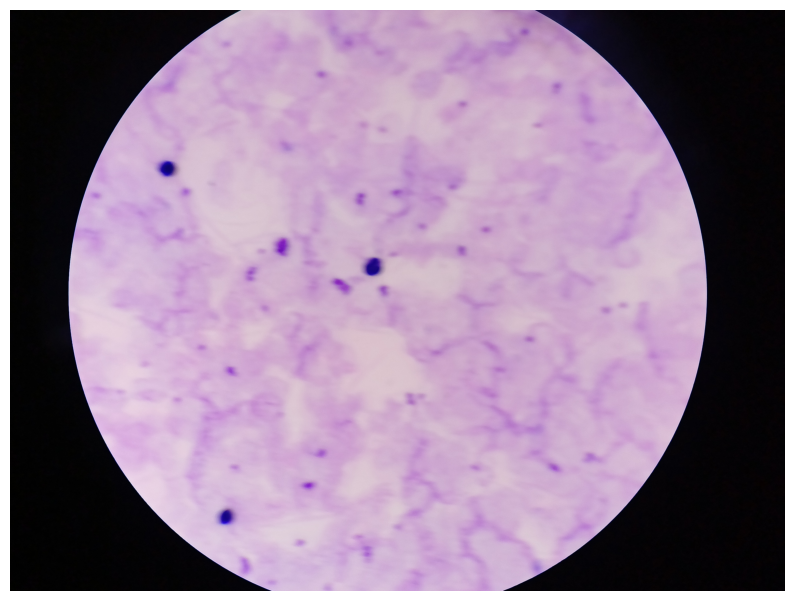

(4000, 3000)


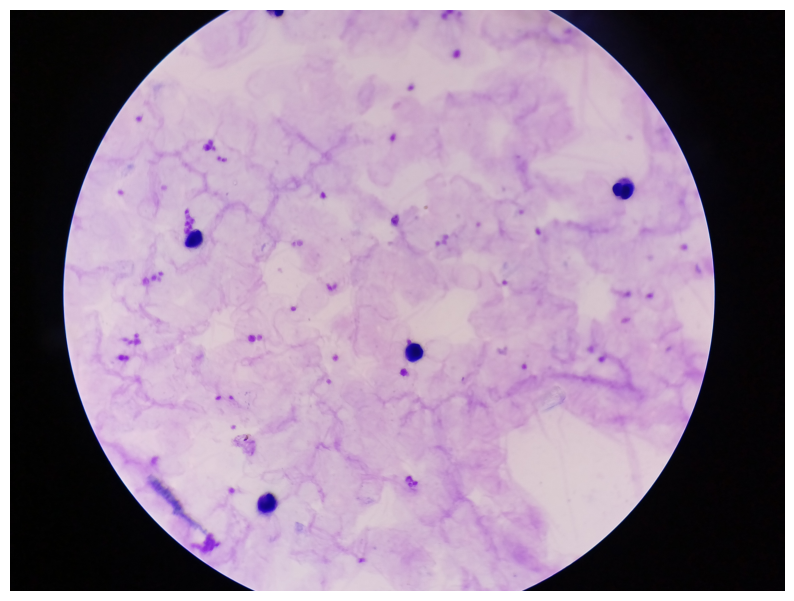

In [40]:
display_random_images(train[train['class_id'] == 2], 20)

(4032, 3016)


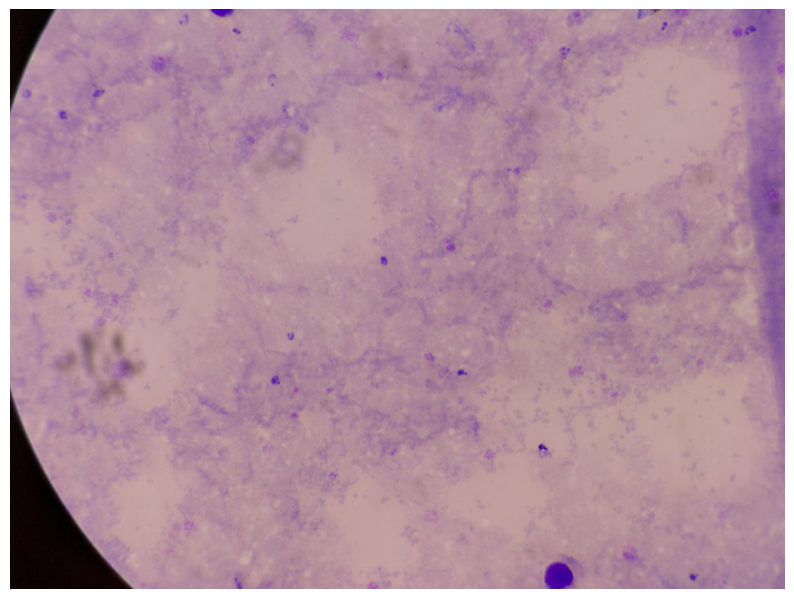

(1920, 1080)


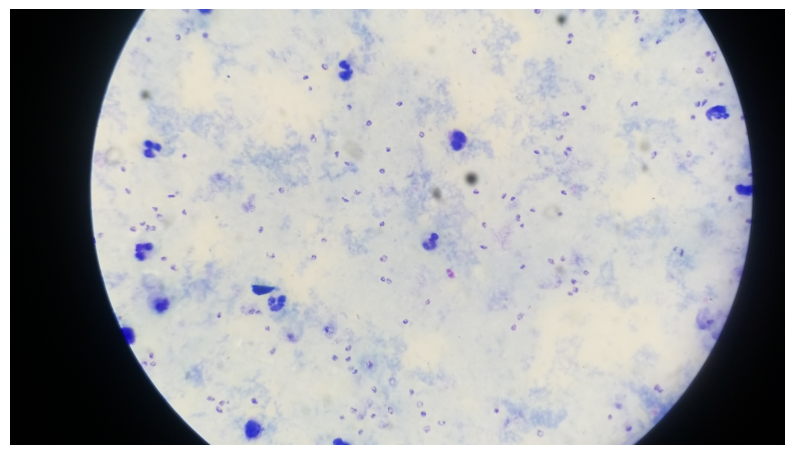

(4032, 3016)


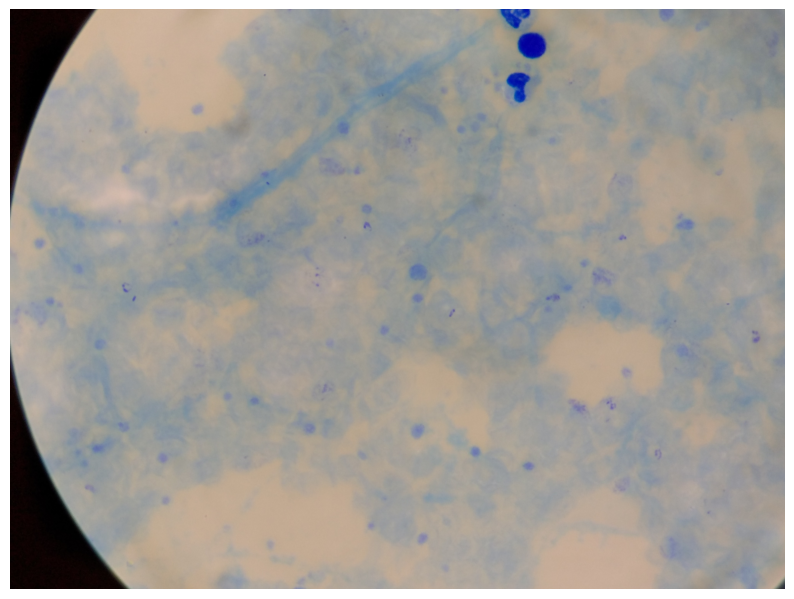

(1920, 1080)


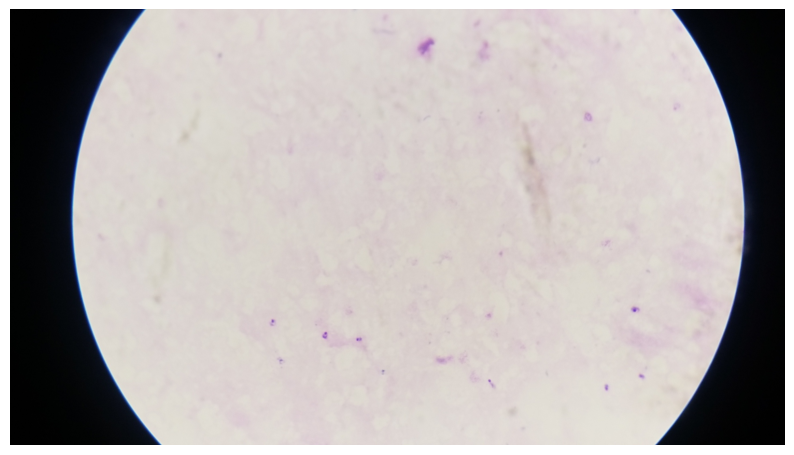

(4032, 3016)


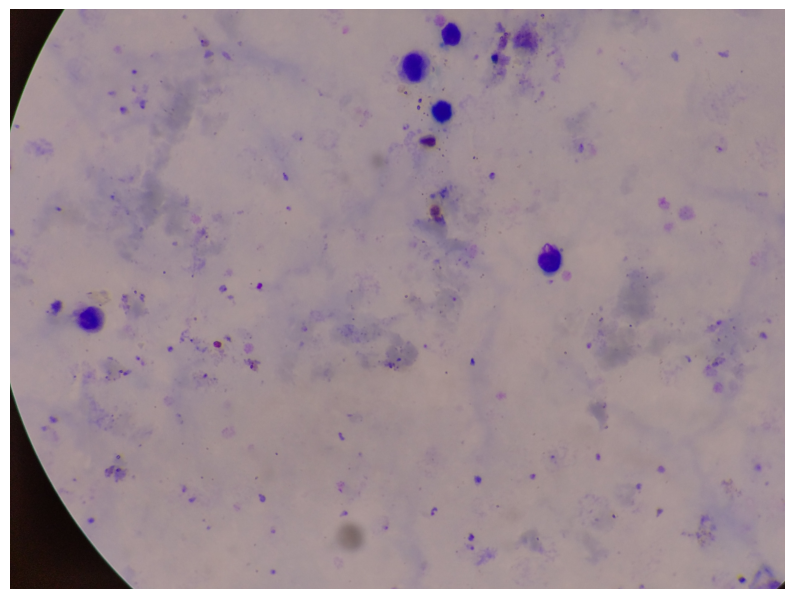

(4032, 3016)


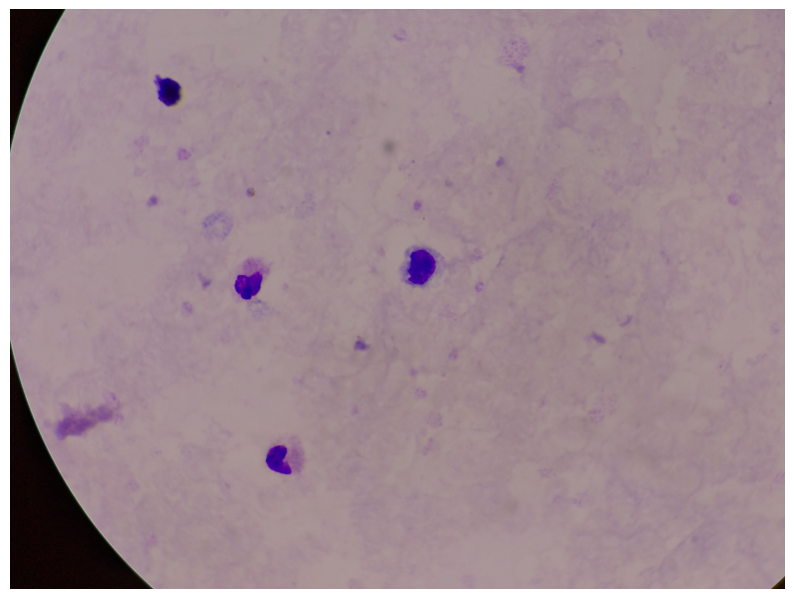

(4032, 3016)


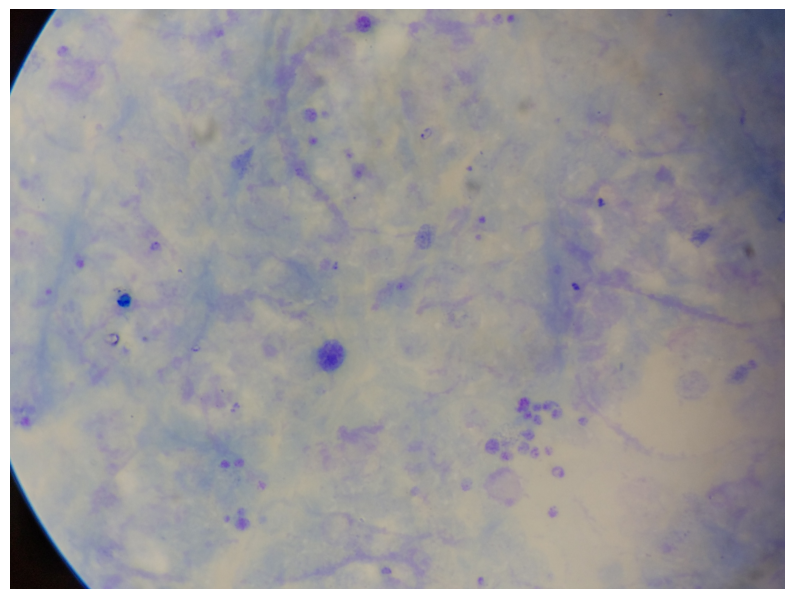

(4032, 3016)


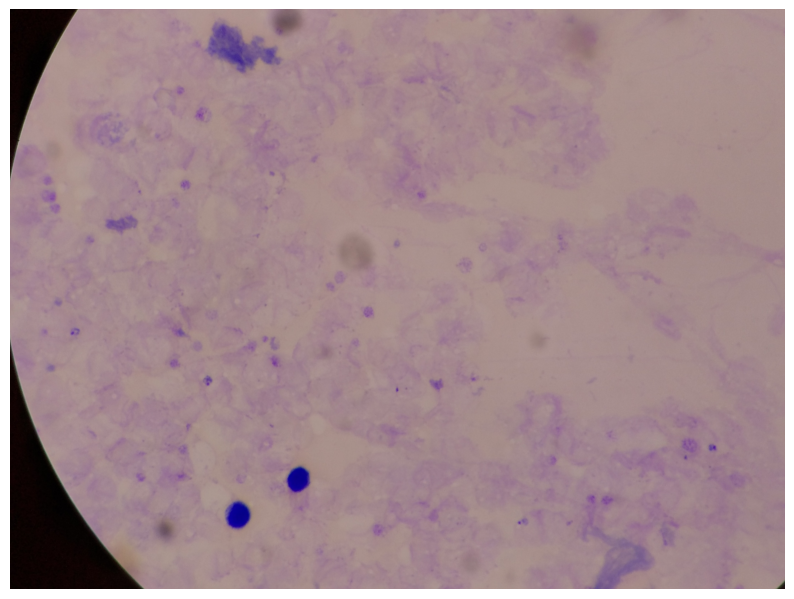

(4032, 3016)


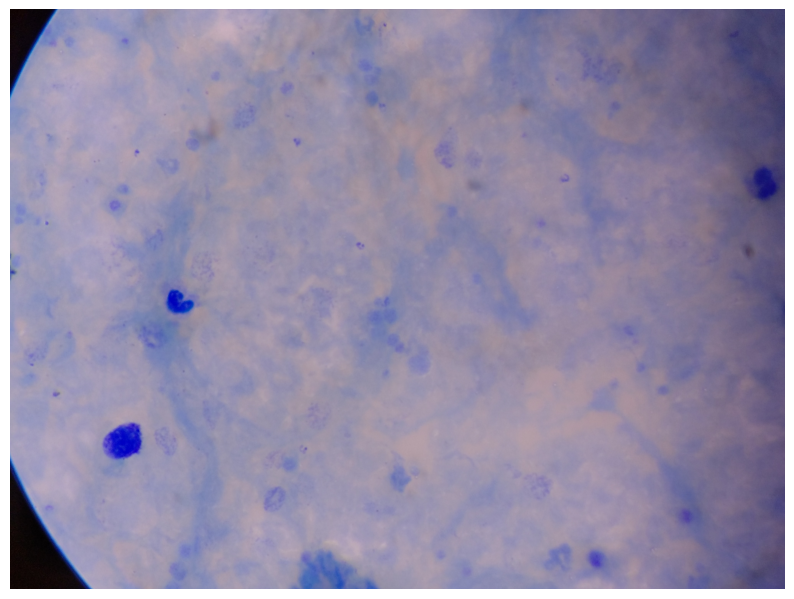

(4032, 3016)


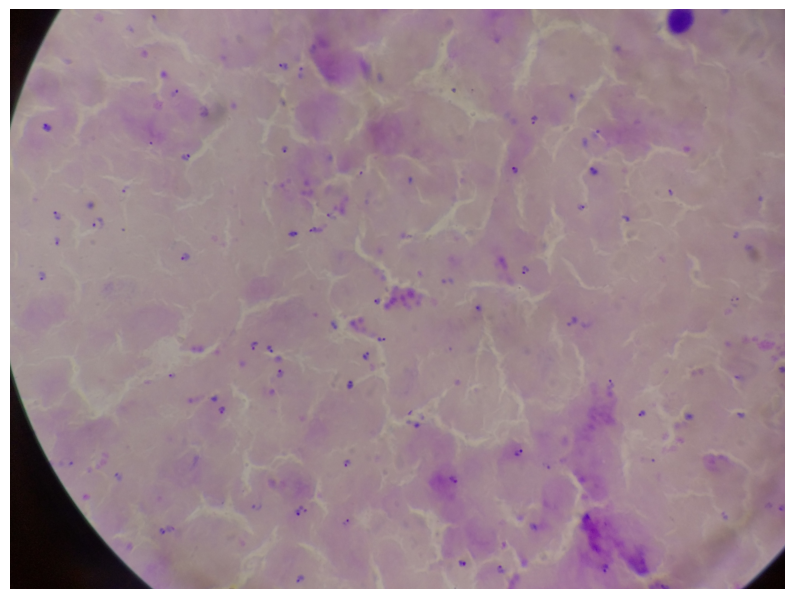

(4160, 3120)


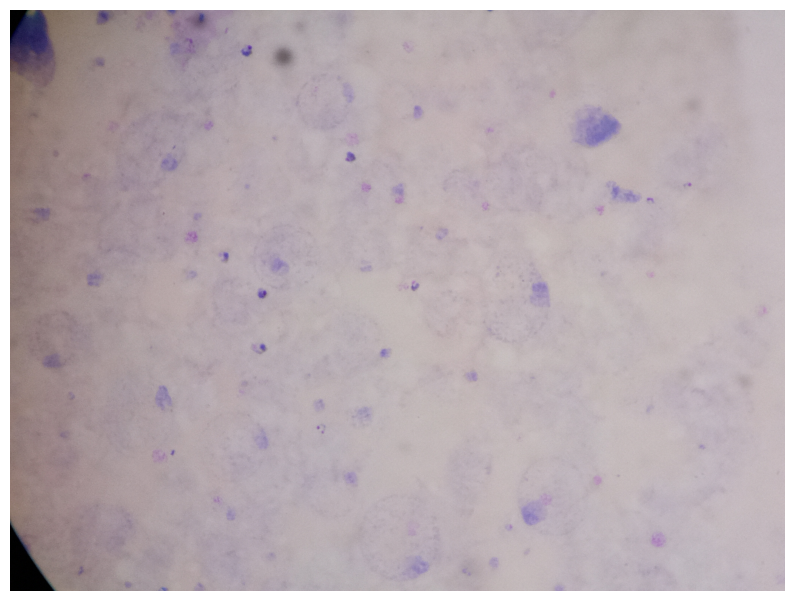

(1920, 1080)


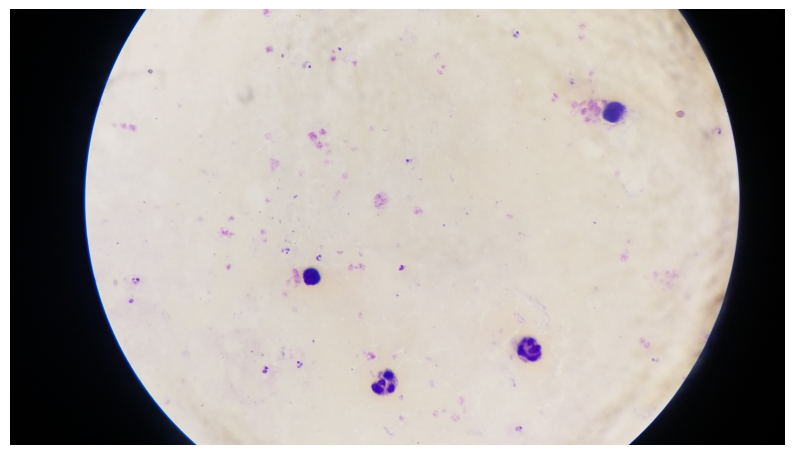

(1920, 1080)


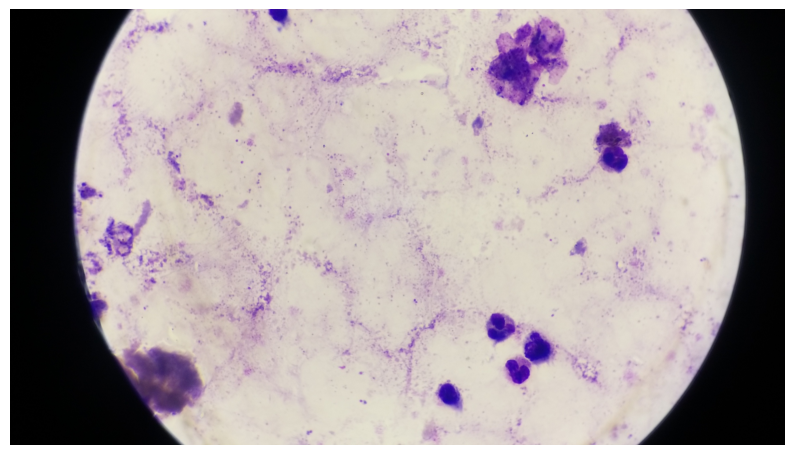

(1920, 1080)


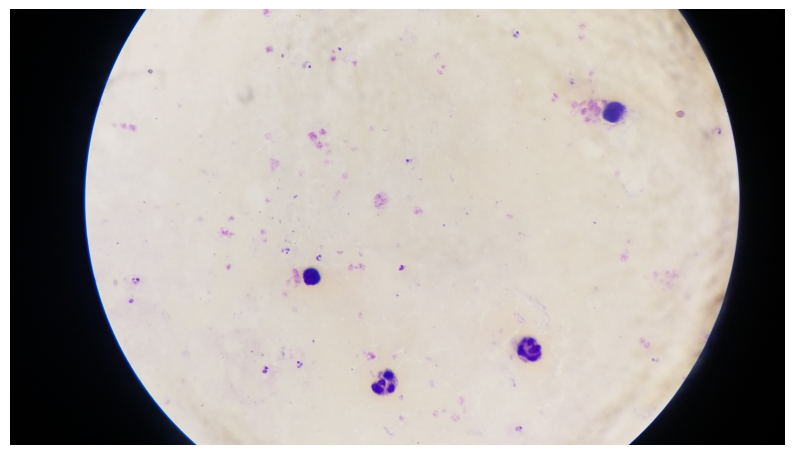

(4160, 3120)


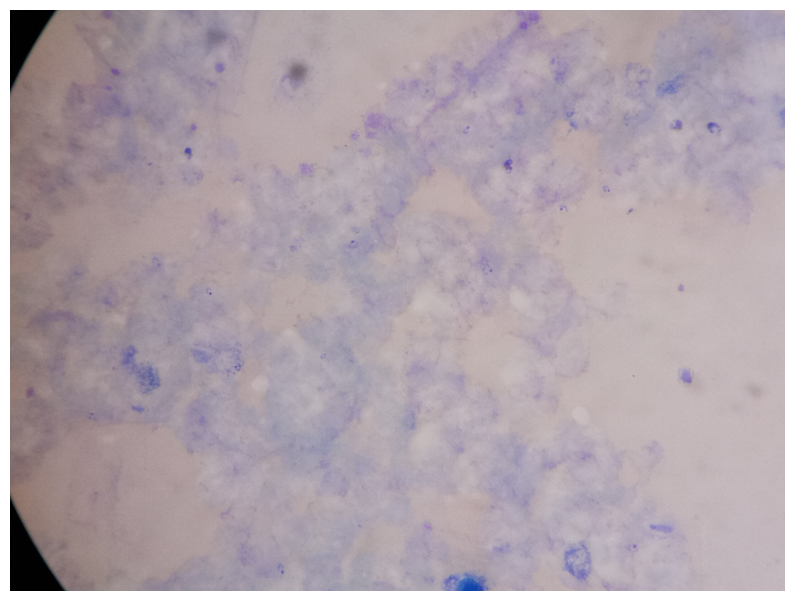

(4032, 3016)


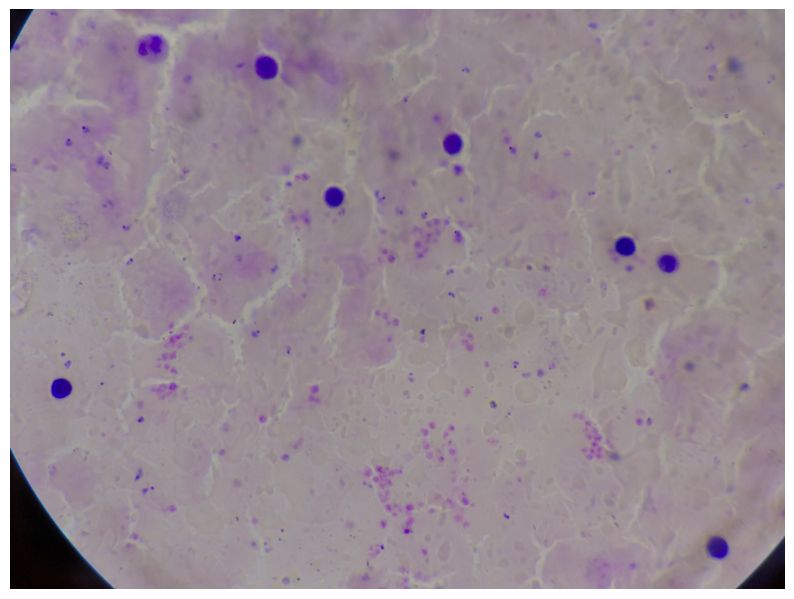

(1920, 1080)


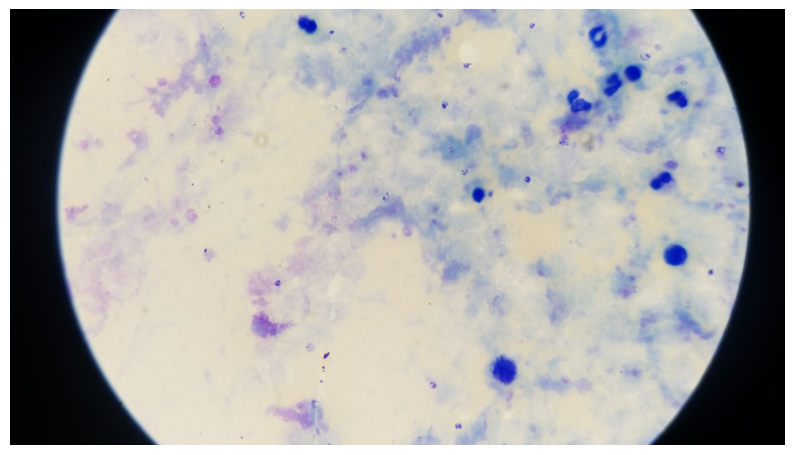

(4032, 3016)


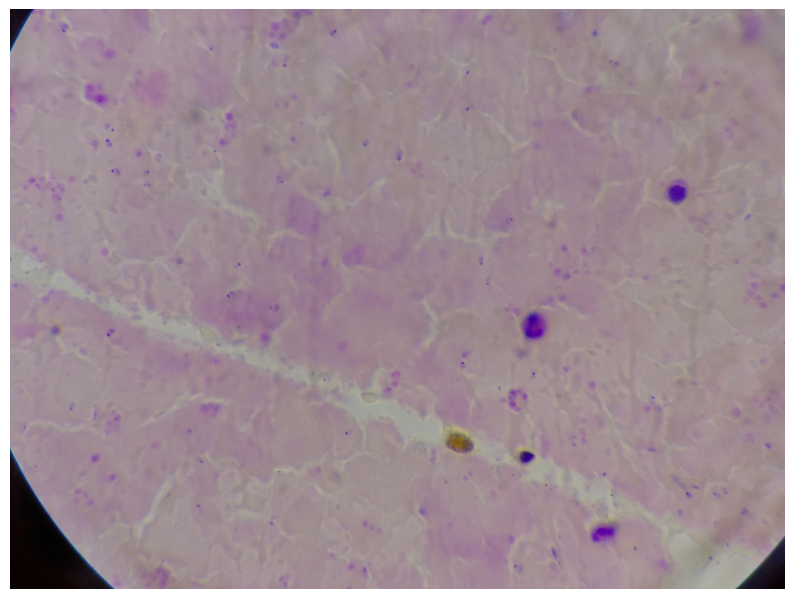

(4160, 3120)


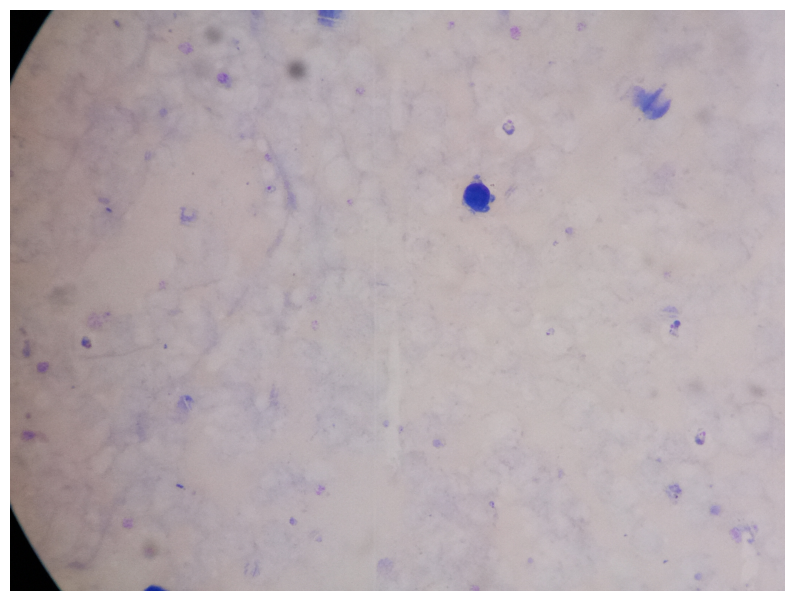

(4160, 3120)


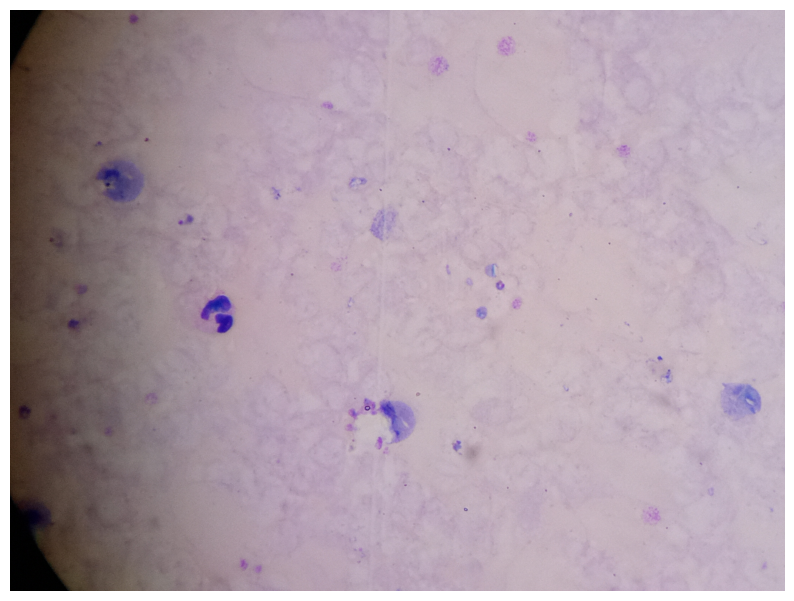

In [39]:
display_random_images(train[train['class_id'] != 2], 20)


In [46]:
train.head()

,Image_ID,class,confidence,ymin,xmin,ymax,xmax,image_path,class_id
0,id_u3q6jdck4j.jpg,Trophozoite,1.0,712,1241,737,1270,/content/drive/MyDrive/challenge_malaria/image...,0
1,id_a6cl90trri.jpg,Trophozoite,1.0,558,1566,600,1604,/content/drive/MyDrive/challenge_malaria/image...,0
2,id_qvc2le9sm8.jpg,Trophozoite,1.0,1317,2788,1448,2914,/content/drive/MyDrive/challenge_malaria/image...,0
3,id_w8xnbd5rvm.jpg,Trophozoite,1.0,925,1744,1041,1823,/content/drive/MyDrive/challenge_malaria/image...,0
4,id_6dop09rk02.jpg,NEG,1.0,0,0,0,0,/content/drive/MyDrive/challenge_malaria/image...,2


In [59]:
i = train.iloc[1]
class_id, xmin, ymin, xmax, ymax= i[["class_id", "xmin", "ymin", "xmax", "ymax"]].values

In [63]:
# Function to plot an image with its bounding boxes
def plot_image_with_boxes2(df, n):

    unique_image_samples = df.groupby('image_path').apply(lambda x: x.sample(1)).reset_index(drop=True)
    # Now, randomly sample n rows from the resulting unique image sample
    sampled_rows = unique_image_samples.sample(n)


    for i, (index, row) in enumerate(sampled_rows.iterrows()):
      # Load the image
      image = cv2.imread(str(row["image_path"]))
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

      # Get image dimensions
      h, w, _ = image.shape

      # Plot the image
      plt.figure(figsize=(10, 10))
      plt.imshow(image)

      # Plot each bounding box
      for _, r in df[df["image_path"] == row["image_path"]].iterrows(): # Use iterrows() to iterate through rows and access values using integer indices
          class_id, xmin, ymin, xmax, ymax = r[["class_id", "xmin", "ymin", "xmax", "ymax"]].values

          # Draw the bounding box
          plt.gca().add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                            edgecolor='red', facecolor='none', linewidth=2))
          plt.text(xmin, ymin - 10, f'Class {int(class_id)}', color='red', fontsize=12, weight='bold')

      plt.axis('off')
      plt.show()

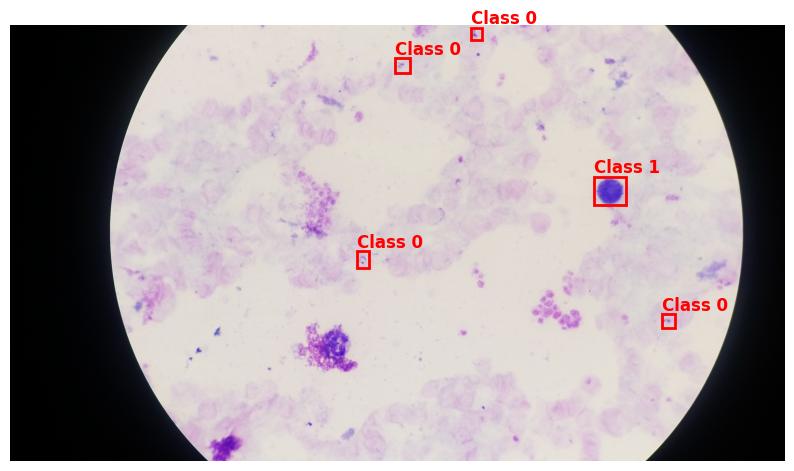

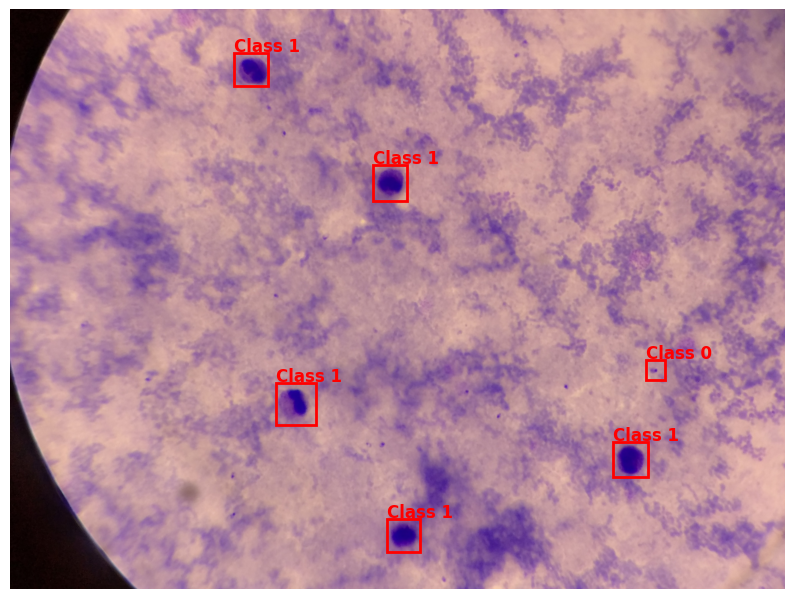

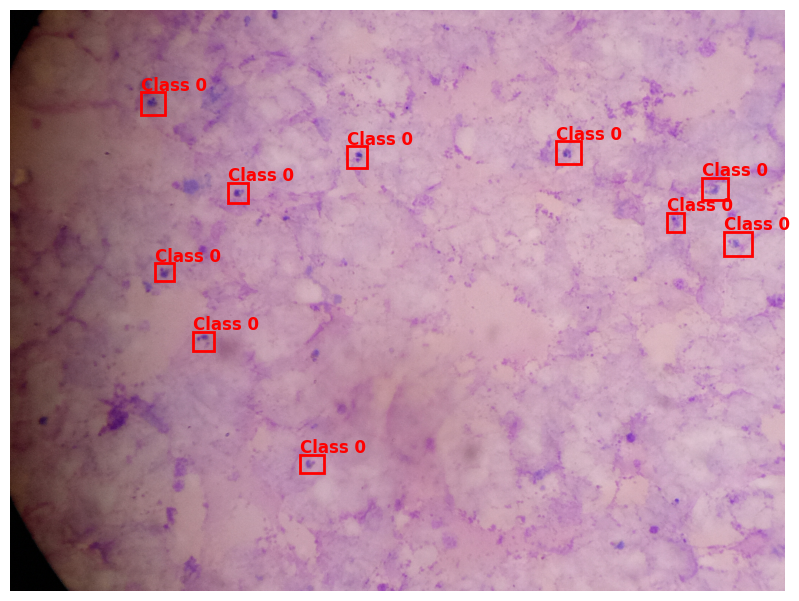

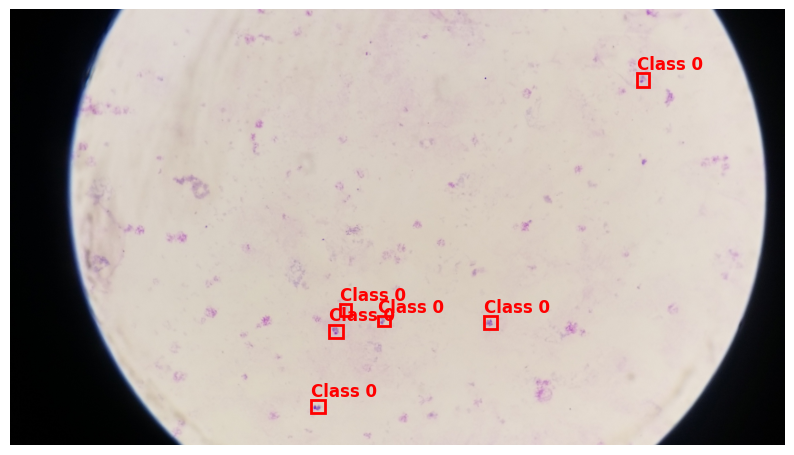

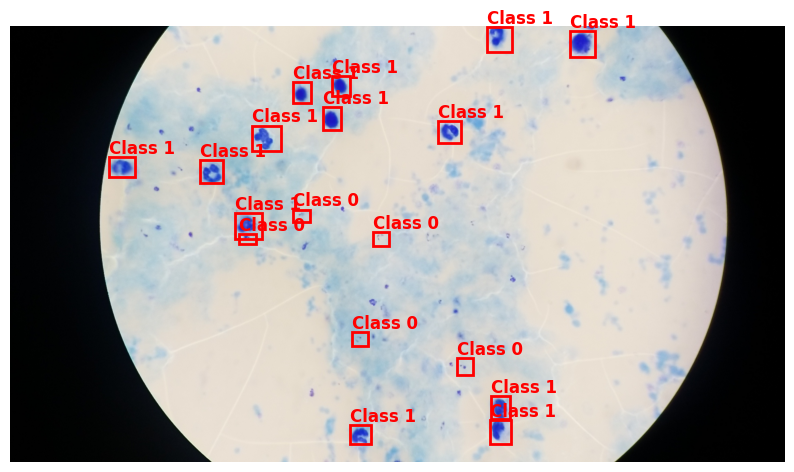

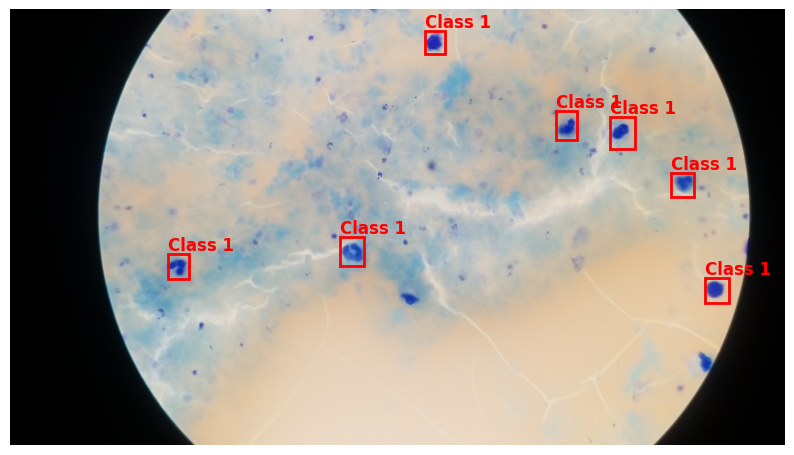

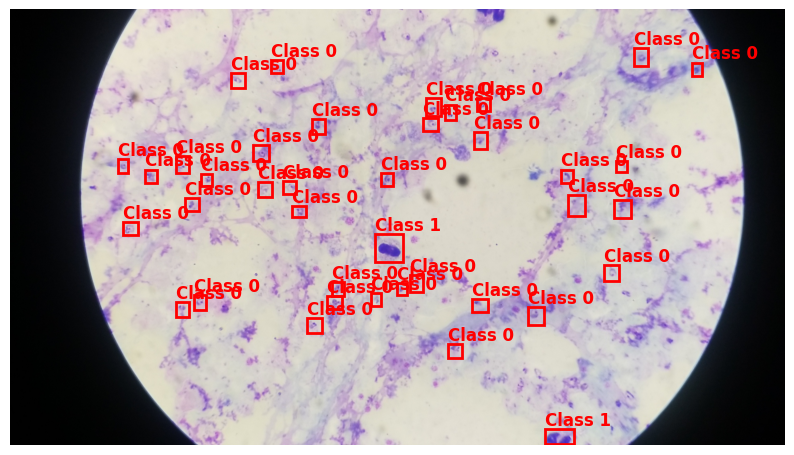

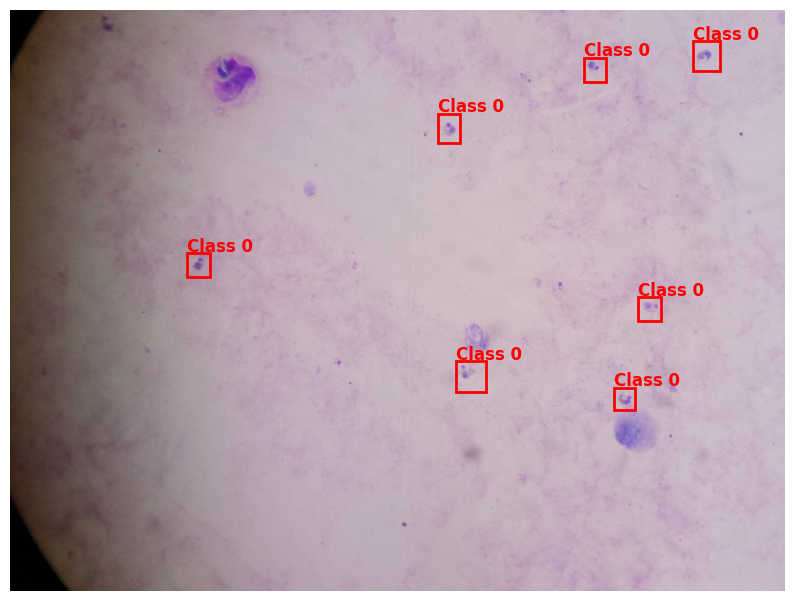

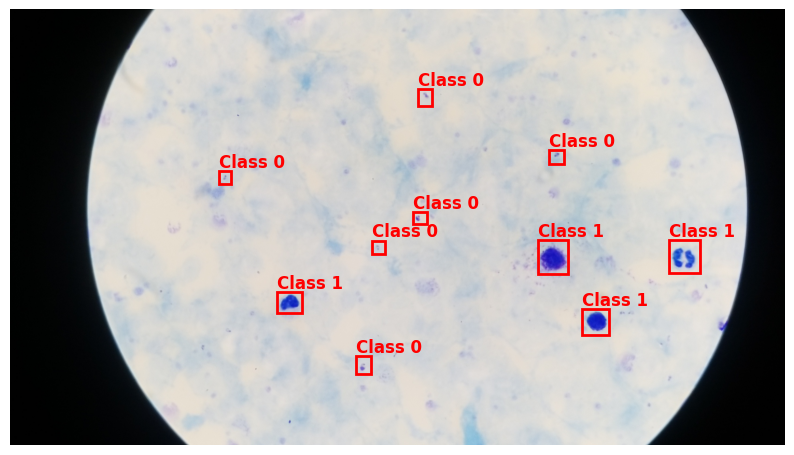

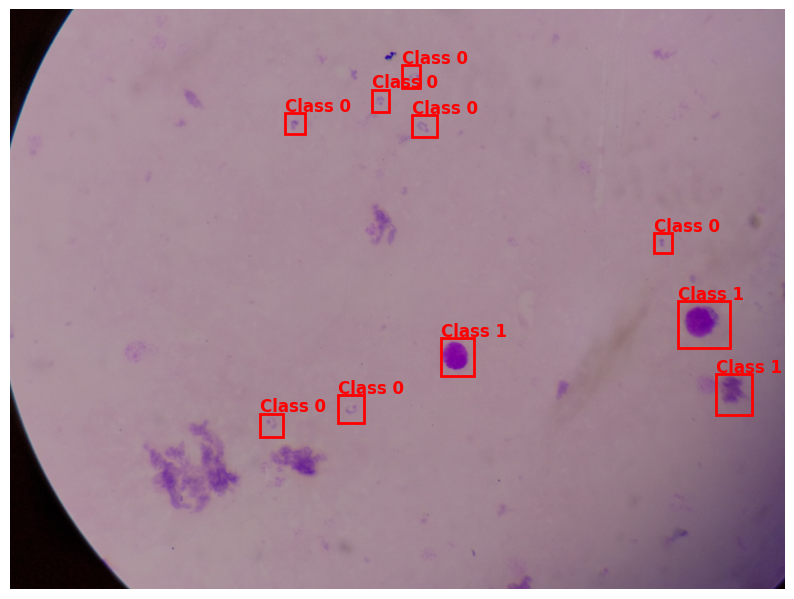

In [64]:
plot_image_with_boxes2(train[train["class_id"] != 2], 10)

# Codigo de esta gente

In [ ]:
# Create a directory to store the copied ZIP file
os.makedirs('../../Lacuna', exist_ok=True)  # Create a directory for storing data locally

# ZIP file path inside Drive
zip_file_path = 'images.zip'

# Destination path outside Drive
target_path = os.path.join('../../Lacuna', 'images.zip')
# Copy, move and verify the ZIP file to the new location
print("Copying images...")
shutil.copy(zip_file_path, target_path)
print("Copied images, out of Drive...")
%cd ../../Lacuna
%ls

Copying images...
Copied images, out of Drive...
/content/Lacuna
images.zip


### **Load metadata from Zindi**

The following cell gets the metadata of the images in the dataset

In [ ]:
url = "https://api.zindi.africa/v1/competitions/lacuna-malaria-detection-challenge/files/lacuna-malaria-detection-challenge20240829-19463-1cpojqt.zip?auth_token=zus.v1.KkSQm0x.8gvz9riRmuArrE8fRDox6UKorX4FUG"
local_zip_filename = '/content/Lacuna/lacuna-malaria-detection.zip'  # Destination path for saving ZIP file outside Drive

print("Downloading dataset from Zindi...")
with requests.get(url, stream=True) as r:
    r.raise_for_status()
    with open(local_zip_filename, 'wb') as f:
        for chunk in r.iter_content(chunk_size=8192):
            f.write(chunk)
print("Download complete: ", local_zip_filename)

print("Extracting files...")
shutil.unpack_archive(local_zip_filename, '/content/Lacuna')
print("Extraction complete.")

Download complete:  /content/Lacuna/lacuna-malaria-detection.zip
Extracting files...
Extraction complete.


In [ ]:
# Path to where your data is stored
DATA_DIR = Path('/content/Lacuna')

# Preview data files available
os.listdir(DATA_DIR)

['SampleSubmission.csv',
 'manifest-c922911ae9101743fc37dc64723c2ee220240829-19463-18lbi0k.json',
 'Lacuna_Malaria_Detection_Challenge_Starter.ipynb',
 'lacuna-malaria-detection.zip',
 'images.zip',
 'Test.csv',
 'Train.csv']

### **Set up directoris for training**

In [ ]:
# Set up directoris for training a yolo model

# Images directories
DATASET_DIR = Path('Lacuna/datasets/dataset')
IMAGES_DIR = DATASET_DIR / 'images'
TRAIN_IMAGES_DIR = IMAGES_DIR / 'train'
VAL_IMAGES_DIR = IMAGES_DIR / 'val'
TEST_IMAGES_DIR = IMAGES_DIR / 'test'

# Labels directories
LABELS_DIR = DATASET_DIR / 'labels'
TRAIN_LABELS_DIR = LABELS_DIR / 'train'
VAL_LABELS_DIR = LABELS_DIR / 'val'
TEST_LABELS_DIR = LABELS_DIR / 'test'

In [ ]:
# Unzip images to 'images' dir
shutil.unpack_archive(DATA_DIR / 'images.zip', 'images')

In [ ]:
# Load train and test files
train = pd.read_csv(DATA_DIR / 'Train.csv')
test = pd.read_csv(DATA_DIR / 'Test.csv')
ss = pd.read_csv(DATA_DIR / 'SampleSubmission.csv')

# Add an image_path column
train['image_path'] = [Path('images/' + x) for x in train.Image_ID]
test['image_path'] = [Path('images/' + x) for x in test.Image_ID]

# Map str classes to ints (label encoding targets)
train['class_id'] = train['class'].map({'Trophozoite': 0, 'WBC': 1, 'NEG': 2})

# Preview the head of the train set
train.head()

,Image_ID,class,confidence,ymin,xmin,ymax,xmax,image_path,class_id
0,id_u3q6jdck4j.jpg,Trophozoite,1.0,712,1241,737,1270,images/id_u3q6jdck4j.jpg,0
1,id_a6cl90trri.jpg,Trophozoite,1.0,558,1566,600,1604,images/id_a6cl90trri.jpg,0
2,id_qvc2le9sm8.jpg,Trophozoite,1.0,1317,2788,1448,2914,images/id_qvc2le9sm8.jpg,0
3,id_w8xnbd5rvm.jpg,Trophozoite,1.0,925,1744,1041,1823,images/id_w8xnbd5rvm.jpg,0
4,id_6dop09rk02.jpg,NEG,1.0,0,0,0,0,images/id_6dop09rk02.jpg,2


In [ ]:
# Filter out NEG class (Negative images - this images have no Trophozoite nor WBC in them)
# Yolo reccomends that when creating labels for negative images, you leave them empty
# https://github.com/ultralytics/yolov5/issues/3218
# As this is a starter nb, we will ignore the negative images
train = train[~(train['class'] == 'NEG')].reset_index(drop = True)

In [ ]:
# Split data into training and validation
train_unique_imgs_df = train.drop_duplicates(subset = ['Image_ID'], ignore_index = True)
X_train, X_val = train_test_split(train_unique_imgs_df, test_size = 0.25, stratify=train_unique_imgs_df['class'], random_state=42)

X_train = train[train.Image_ID.isin(X_train.Image_ID)]
X_val = train[train.Image_ID.isin(X_val.Image_ID)]

# Check shapes of training and validation data
X_train.shape, X_val.shape

((17354, 9), (5488, 9))

In [ ]:
# Preview target distribution, seems there a class imbalance that needs to be handled
X_train['class'].value_counts(normalize = True), X_val['class'].value_counts(normalize = True)

(class
 Trophozoite    0.688141
 WBC            0.311859
 Name: proportion, dtype: float64,
 class
 Trophozoite    0.709913
 WBC            0.290087
 Name: proportion, dtype: float64)

In [ ]:
# Check if dirs exist, if they do, remove them, otherwise create them.
# This only needs to run once
for DIR in [TRAIN_IMAGES_DIR,VAL_IMAGES_DIR, TEST_IMAGES_DIR, TRAIN_LABELS_DIR,VAL_LABELS_DIR,TEST_LABELS_DIR]:
  if DIR.exists():
    shutil.rmtree(DIR)
  DIR.mkdir(parents=True, exist_ok = True)

In [ ]:
# Copy train, val and test images to their respective dirs
for img in tqdm(X_train.image_path.unique()):
  shutil.copy(img, TRAIN_IMAGES_DIR / img.parts[-1])

for img in tqdm(X_val.image_path.unique()):
  shutil.copy(img, VAL_IMAGES_DIR / img.parts[-1])

for img in tqdm(test.image_path.unique()):
  shutil.copy(img, TEST_IMAGES_DIR / img.parts[-1])

  0%|          | 0/1544 [00:00<?, ?it/s]

  0%|          | 0/515 [00:00<?, ?it/s]

  0%|          | 0/1178 [00:00<?, ?it/s]

In [ ]:
# Function to convert the bboxes to yolo format and save them
def save_yolo_annotation(row):
    image_path, class_id, output_dir = row['image_path'], row['class_id'], row['output_dir']

    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Could not read image from path: {image_path}")

    height, width, _ = img.shape

    label_file = Path(output_dir) / f"{Path(image_path).stem}.txt"

    ymin, xmin, ymax, xmax = row['ymin'], row['xmin'], row['ymax'], row['xmax']

    # Normalize the coordinates
    x_center = (xmin + xmax) / 2 / width
    y_center = (ymin + ymax) / 2 / height
    bbox_width = (xmax - xmin) / width
    bbox_height = (ymax - ymin) / height

    with open(label_file, 'a') as f:
        f.write(f"{class_id} {x_center:.6f} {y_center:.6f} {bbox_width:.6f} {bbox_height:.6f}\n")

# Parallelize the annotation saving process
def process_dataset(dataframe, output_dir):
    dataframe['output_dir'] = output_dir
    with multiprocessing.Pool() as pool:
        list(tqdm(pool.imap(save_yolo_annotation, dataframe.to_dict('records')), total=len(dataframe)))

# Save train and validation labels to their respective dirs
process_dataset(X_train, TRAIN_LABELS_DIR)
process_dataset(X_val, VAL_LABELS_DIR)

<ipython-input-16-f4a829c8e24a>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe['output_dir'] = output_dir


  0%|          | 0/17354 [00:00<?, ?it/s]

<ipython-input-16-f4a829c8e24a>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe['output_dir'] = output_dir


  0%|          | 0/5488 [00:00<?, ?it/s]

In [ ]:
# Train images dir
TRAIN_IMAGES_DIR

PosixPath('datasets/dataset/images/train')

In [ ]:
# Create a data.yaml file required by yolo
class_names = train['class'].unique().tolist()
num_classes = len(class_names)

data_yaml = {
    'train': '/content/' + str(TRAIN_IMAGES_DIR),
    'val': '/content/' + str(VAL_IMAGES_DIR),
    'test': '/content/' + str(TEST_IMAGES_DIR),
    'nc': num_classes,
    'names': class_names
}

yaml_path = 'data.yaml'
with open(yaml_path, 'w') as file:
    yaml.dump(data_yaml, file, default_flow_style=False)

# Preview data yaml file
data_yaml

{'train': '/content/datasets/dataset/images/train',
 'val': '/content/datasets/dataset/images/val',
 'test': '/content/datasets/dataset/images/test',
 'nc': 2,
 'names': ['Trophozoite', 'WBC']}

Plotting id_3foaoydqtd.jpg with 4 bounding boxes.


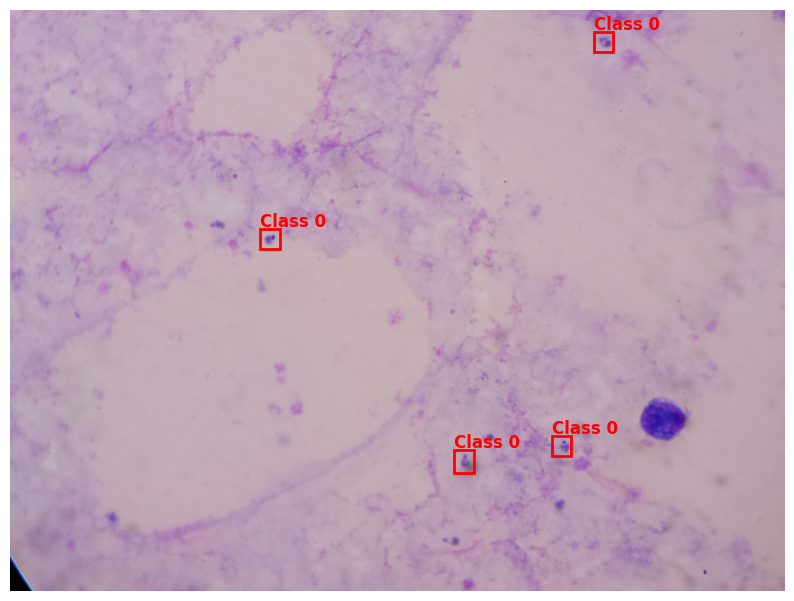

Plotting id_u8gkyu4gc4.jpg with 8 bounding boxes.


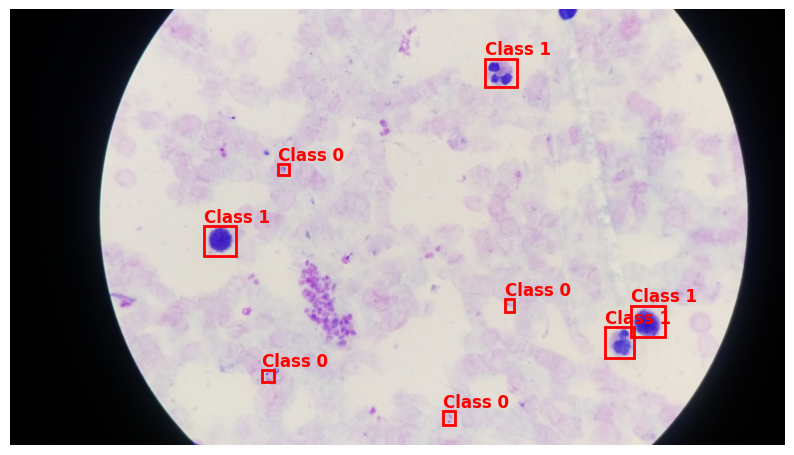

Plotting id_44fqfdw5v9.jpg with 5 bounding boxes.


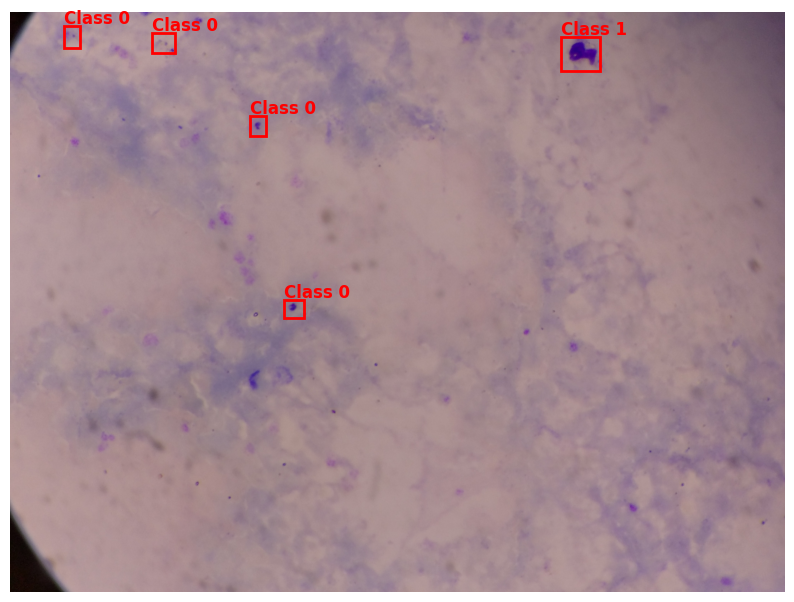

In [ ]:
# Plot some images and their bboxes to ensure the conversion was done correctly
def load_annotations(label_path):
    with open(label_path, 'r') as f:
        lines = f.readlines()
    boxes = []
    for line in lines:
        class_id, x_center, y_center, width, height = map(float, line.strip().split())
        boxes.append((class_id, x_center, y_center, width, height))
    return boxes

# Function to plot an image with its bounding boxes
def plot_image_with_boxes(image_path, boxes):
    # Load the image
    image = cv2.imread(str(image_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get image dimensions
    h, w, _ = image.shape

    # Plot the image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)

    # Plot each bounding box
    for box in boxes:
        class_id, x_center, y_center, width, height = box
        # Convert YOLO format to corner coordinates
        xmin = int((x_center - width / 2) * w)
        ymin = int((y_center - height / 2) * h)
        xmax = int((x_center + width / 2) * w)
        ymax = int((y_center + height / 2) * h)

        # Draw the bounding box
        plt.gca().add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                          edgecolor='red', facecolor='none', linewidth=2))
        plt.text(xmin, ymin - 10, f'Class {int(class_id)}', color='red', fontsize=12, weight='bold')

    plt.axis('off')
    plt.show()

# Directories for images and labels
IMAGE_DIR = TRAIN_IMAGES_DIR
LABEL_DIR = TRAIN_LABELS_DIR

# Plot a few images with their annotations
for image_name in os.listdir(IMAGE_DIR)[:3]:
    image_path = IMAGE_DIR / image_name
    label_path = LABEL_DIR / (image_name.replace('.jpg', '.txt').replace('.png', '.txt'))

    if label_path.exists():
        boxes = load_annotations(label_path)
        print(f"Plotting {image_name} with {len(boxes)} bounding boxes.")
        plot_image_with_boxes(image_path, boxes)
    else:
        print(f"No annotations found for {image_name}.")


### **Load a yolo pretrained model**

In [ ]:
# Load a yolo pretrained model
model = YOLO('yolov8m.pt')

# Fine tune model to our data
model.train(
    data='data.yaml',          # Path to the dataset configuration
    epochs=30,                 # Number of epochs
    imgsz=2048,                # Image size (height, width)
    batch=8,                   # Batch size
    device=0,                  # Device to use (0 for the first GPU)
    patience=5)

In [ ]:
# Validate the model on the validation set
model = YOLO('/content/runs/detect/train/weights/best.pt')
results = model.val()

In [ ]:
# Load the trained YOLO model
model = YOLO('/content/runs/detect/train/weights/best.pt')

# Path to the test images directory
test_dir_path = '/content/datasets/dataset/images/test'

# Get a list of all image files in the test directory
image_files = os.listdir(test_dir_path)

# Initialize an empty list to store the results for all images
all_data = []

# Iterate through each image in the directory
for image_file in tqdm(image_files):
    # Full path to the image
    img_path = os.path.join(test_dir_path, image_file)

    # Make predictions on the image
    results = model(img_path)

    # Extract bounding boxes, confidence scores, and class labels
    boxes = results[0].boxes.xyxy.tolist()  # Bounding boxes in xyxy format
    classes = results[0].boxes.cls.tolist()  # Class indices
    confidences = results[0].boxes.conf.tolist()  # Confidence scores
    names = results[0].names  # Class names dictionary

    if not boxes:
        # If no detections, add NEG as the class
        all_data.append({
            'Image_ID': image_file,
            'class': 'NEG',
            'confidence': 1.0,  # You can set this to a default value
            'ymin': 0,  # Default value (no detection)
            'xmin': 0,  # Default value (no detection)
            'ymax': 0,  # Default value (no detection)
            'xmax': 0   # Default value (no detection)
        })
    else:
        # Iterate through the results for this image
        for box, cls, conf in zip(boxes, classes, confidences):
            x1, y1, x2, y2 = box
            detected_class = names[int(cls)]  # Get the class name from the names dictionary

            # Add the result to the all_data list
            all_data.append({
                'Image_ID': image_file,
                'class': detected_class,
                'confidence': conf,
                'ymin': y1,
                'xmin': x1,
                'ymax': y2,
                'xmax': x2
            })

# Convert the list to a DataFrame for all images
sub = pd.DataFrame(all_data)

In [ ]:
sub.head()

In [ ]:
sub['class'].value_counts()

In [ ]:
# Create submission file to be uploaded to Zindi for scoring
sub.to_csv('benchmark_submission.csv', index = False)